### Connect to BQ

In [ ]:
from google.colab import auth
auth.authenticate_user()
print('Authenticated')

Authenticated


## Optional: Enable data table display
There is ``google.colab.data_table``library in Colab that enables table display, useful for large pandas dataframes, will show the data as interactive table. It can be enabled using the code below:

In [ ]:
%load_ext google.colab.data_table

The google.colab.data_table extension is already loaded. To reload it, use:
  %reload_ext google.colab.data_table


#BigQuery via google-cloud-bigquery


### Declaring the id of the cloud project that will be used in this notebook.

In [ ]:
project_id = 'my-project-dec9'

In [ ]:
from google.cloud import bigquery

client = bigquery.Client(project=project_id)

sample_count = 10000
row_count = client.query('''
  SELECT 
    COUNT(*) as total
  FROM `my-project-dec9.Demo.Outputnew`''').to_dataframe().total[0]

df = client.query('''
  SELECT
    *
  FROM
    `my-project-dec9.Demo.Outputnew`
#  WHERE RAND() < %d/%d
'''
% (sample_count, row_count)).to_dataframe()

print('Full dataset has %d rows' % row_count)

No project ID could be determined. Consider running `gcloud config set project` or setting the GOOGLE_CLOUD_PROJECT environment variable


Full dataset has 2172 rows


In [ ]:
df.head()

,Costs,ABC,Discount,Category,Description,SupplierContact,Product,CustomerID,OrderID,ShipperID,...,monetary,Quantity,ProductID,recency,OrderDate,Year,SupplierCountry,XYZ,EmployeeID,EmployeeName
0,313.11,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,48,10317,3,...,7907.41,20,1,149,2010-07-27,2010,UK,Y,1,Rock Roll
1,292.98,C,48.51,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,32,10370,3,...,82519.85,15,1,141,2010-07-30,2010,UK,Y,1,Rock Roll
2,177.71,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,80,10576,3,...,68265.67,10,1,109,2011-09-19,2011,UK,Y,1,Rock Roll
3,326.92,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,51,10590,3,...,21133.12,20,1,74,2011-10-03,2011,UK,Y,1,Rock Roll
4,1302.45,C,291.04,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,80,10847,3,...,68265.67,80,1,109,2012-09-19,2012,UK,Y,1,Rock Roll


### Describe the sampled data

In [ ]:
df.describe()

,Costs,Discount,CustomerID,OrderID,ShipperID,frequency,Month,SupplierID,Sales,Profit,ID,Freight,CategoryID,monetary,Quantity,ProductID,recency,Year,EmployeeID
count,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000,2172.000000
mean,653.912021,49.608559,43.720994,10662.680479,1.988950,21.352670,6.525783,14.471915,820.970497,167.058485,14.471915,50.420506,3.972836,56855.378412,23.967311,40.710866,77.161602,2011.426335,4.971915
std,1577.331315,226.864986,25.357716,243.294300,0.595444,14.210496,3.275860,8.236299,2002.528371,455.554336,8.236299,17.351569,2.294868,53898.318415,19.189360,22.175948,93.808984,0.900180,2.870720
min,1.830000,0.000000,1.000000,10248.000000,1.000000,1.000000,1.000000,1.000000,2.120000,0.270000,1.000000,12.450000,1.000000,66.000000,1.000000,1.000000,0.000000,2009.000000,1.000000
25%,123.350000,0.000000,23.000000,10452.000000,2.000000,9.000000,3.000000,7.000000,154.260000,25.185000,7.000000,34.900000,2.000000,13306.880000,10.000000,22.000000,16.000000,2011.000000,3.000000
50%,282.275000,0.000000,39.000000,10659.500000,2.000000,18.000000,7.000000,14.000000,355.070000,63.580000,14.000000,50.460000,3.000000,39838.910000,20.000000,41.000000,29.000000,2012.000000,5.000000
75%,648.237500,26.835000,63.000000,10868.250000,2.000000,35.000000,9.000000,21.000000,796.400000,148.115000,21.000000,65.670000,6.000000,82519.850000,30.000000,60.000000,141.000000,2012.000000,8.000000
max,32160.010000,7292.520000,127.000000,11083.000000,3.000000,48.000000,12.000000,29.000000,43755.120000,11595.110000,29.000000,79.960000,8.000000,201320.460000,150.000000,77.000000,896.000000,2013.000000,9.000000


In [ ]:
from google.colab import data_table
data_table.DataTable(df, include_index=True, num_rows_per_page=5)

,Costs,ABC,Discount,Category,Description,SupplierContact,Product,CustomerID,OrderID,ShipperID,...,monetary,Quantity,ProductID,recency,OrderDate,Year,SupplierCountry,XYZ,EmployeeID,EmployeeName
0,313.11,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,48,10317,3,...,7907.41,20,1,149,2010-07-27,2010,UK,Y,1,Rock Roll
1,292.98,C,48.51,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,32,10370,3,...,82519.85,15,1,141,2010-07-30,2010,UK,Y,1,Rock Roll
2,177.71,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,80,10576,3,...,68265.67,10,1,109,2011-09-19,2011,UK,Y,1,Rock Roll
3,326.92,C,0.00,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,51,10590,3,...,21133.12,20,1,74,2011-10-03,2011,UK,Y,1,Rock Roll
4,1302.45,C,291.04,Men´s Clothes,Fashion for Men,Peter Shilton,Lenin Jeansshorts,80,10847,3,...,68265.67,80,1,109,2012-09-19,2012,UK,Y,1,Rock Roll
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2167,6430.93,B,1165.02,Womens wear,Fashion for Women,Juha Mieto,Minnki Pälsii,23,10434,1,...,91362.15,18,76,64,2011-01-31,2011,Finland,Y,6,Lennart Skoglund
2168,2995.70,B,369.84,Womens wear,Fashion for Women,Juha Mieto,Minnki Pälsii,23,10604,1,...,91362.15,10,76,64,2012-02-14,2012,Finland,Y,6,Lennart Skoglund
2169,16926.02,B,1919.05,Womens wear,Fashion for Women,Juha Mieto,Minnki Pälsii,23,11050,1,...,91362.15,50,76,64,2013-01-24,2013,Finland,Y,6,Lennart Skoglund
2170,668.64,B,113.72,Womens wear,Fashion for Women,Juha Mieto,Minnki Pälsii,68,11075,1,...,11397.05,2,76,47,2013-02-10,2013,Finland,Y,6,Lennart Skoglund


In [ ]:
!pip install -U dataprep
#After installing, if there are any errors, run pip install line again

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from dataprep.eda import *


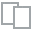
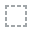
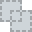
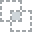
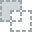
...
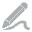
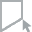
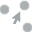
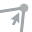
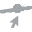

In [ ]:
plot(df)


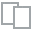
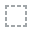
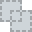
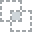
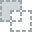
...
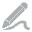
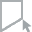
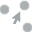
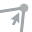
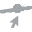

In [ ]:
#Checking correlation
plot_correlation(df)

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import math


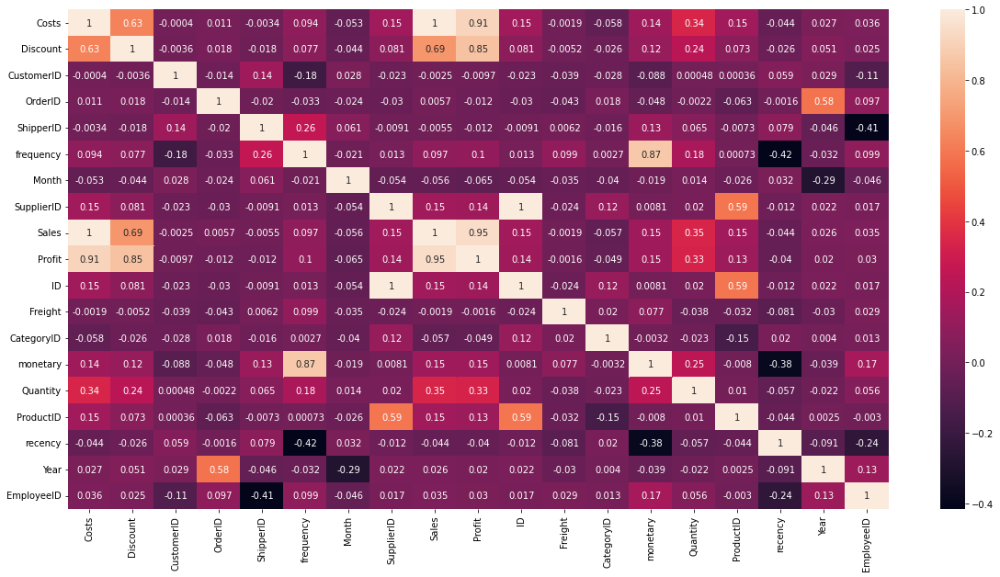

In [ ]:
plt.figure(figsize = (20,10))
sns.heatmap(df.corr(),annot = True)

We can see high correlation between cost and discount, also between profit and discount. These features are interconnected, so we did not receive any new information from this correlation, we will remove these features when building the model.

In [ ]:
#Pandas Profiling
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
#After installing, if there are any errors, run pip install line again

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


In [ ]:
from pandas_profiling import ProfileReport
profile=ProfileReport(df, title="Pandas Profiling Report", html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file("PandasProfile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#**Conclusions**

1. 	ABC analysis has shown that there are only items from categories B and C present in our dataset.
2.	XYZ analysis has shown that there are only category Y items present in our shop.
3.	The discount value in 92% of orders is between USD 0 and USD 146.
4.	There are 8 categories of items being sold:
•	Sportswear is 26% of all items in the shop;
•	Kid’s clothes, men’s and women’s clothes are 14% each;
•	The rest of the categories have less than 10% each.
5.	The largest bin for transaction values is for the bin with translations varying from USD 2 to USD 877, we can observe it in 87% of all sales cases. The next bin for sales is for transaction values varying between USD 877 and USD 1752, this bin represents 13% of all cases.
6.	Profit for our shop lies between 0 and USD 232 in majority of cases (84%). 
7.	We can see that the majority of sales happened in 2012, 48% of all sales are date back to 2012. It would be interesting to check if the sales values correlate to the amount of transaction in 2012 and if the sales in monetary value are also the highest in 2012.
8.	Main suppliers of the goods presented in our shop are USA, Germany, Australia, UK.
9. We can see high correlation between cost and discount, also between profit and discount. These features are interconnected, so we did not receive any new information from this correlation, we will remove these features when building the model.

In [ ]:
!pip install pycaret #After installing, run again the file loading and libraries initiating

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2172 entries, 0 to 2171
Data columns (total 29 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Costs            2172 non-null   float64
 1   ABC              2172 non-null   object 
 2   Discount         2172 non-null   float64
 3   Category         2172 non-null   object 
 4   Description      2172 non-null   object 
 5   SupplierContact  2172 non-null   object 
 6   Product          2172 non-null   object 
 7   CustomerID       2172 non-null   int64  
 8   OrderID          2172 non-null   int64  
 9   ShipperID        2172 non-null   int64  
 10  frequency        2172 non-null   int64  
 11  Month            2172 non-null   int64  
 12  SupplierID       2172 non-null   int64  
 13  Sales            2172 non-null   float64
 14  Profit           2172 non-null   float64
 15  Supplier         2172 non-null   object 
 16  ID               2172 non-null   int64  
 17  Freight       

In [ ]:
from pycaret.regression import *

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from datetime import datetime
import statsmodels.api as sm
import numpy as np 
import xgboost as xgb
from sklearn.metrics import mean_squared_error, mean_absolute_error
import imageio
import os
from statsmodels.graphics.tsaplots import plot_acf

In [ ]:
df['OrderDate'] = pd.to_datetime(df['OrderDate'], infer_datetime_format=True)

In [ ]:
df.to_csv('/content/Case3_TS.csv') # Dataset for visualization

In [ ]:
df2_ds = df[['OrderID','OrderDate', 'Sales']]

In [ ]:
df2_ds = df[['OrderDate', 'Sales']]
df2_ds = df2_ds.sort_values(by=['OrderDate'], ascending=[True])

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df2_ds

,OrderDate,Sales
478,2009-07-21,159.80
448,2009-07-21,805.20
481,2009-07-21,109.20
440,2009-07-21,360.00
602,2009-07-21,300.75
...,...,...
340,2013-03-29,132.45
1011,2013-03-29,21077.20
1627,2013-03-29,1454.80
112,2013-03-29,67.15


In [ ]:
aggregated=df2_ds.groupby('OrderDate',as_index=True).sum() # for aggregated output, returns the object with group labels as an index

In [ ]:
aggregated.head()

,Sales
OrderDate,
2009-07-21,1734.95
2009-08-19,723.95
2009-09-02,1046.85
2009-09-16,752.06
2009-09-18,1817.20


In [ ]:
aggregated['OrderDate'] = aggregated.index

In [ ]:
aggregated.head()

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/google/colab/data_table.py", line 193, in _repr_javascript_module_
    return self._gen_js(self._preprocess_dataframe())
  File "/usr/local/lib/python3.7/dist-packages/google/colab/data_table.py", line 169, in _preprocess_dataframe
    dataframe = dataframe.reset_index()
  File "/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py", line 311, in wrapper
    return func(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py", line 5799, in reset_index
    new_obj.insert(0, name, level_values)
  File "/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py", line 4414, in insert
    raise ValueError(f"cannot insert {column}, already exists")
ValueError: cannot insert OrderDate, already exists


,Sales,OrderDate
OrderDate,,
2009-07-21,1734.95,2009-07-21
2009-08-19,723.95,2009-08-19
2009-09-02,1046.85,2009-09-02
2009-09-16,752.06,2009-09-16
2009-09-18,1817.20,2009-09-18


In [ ]:
print(min(aggregated.index))
print(max(aggregated.index))

2009-07-21 00:00:00
2013-03-29 00:00:00


In [ ]:
from google.colab import auth
auth.authenticate_user()
print('Authenticated')

Authenticated


In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='Demo.Case3_TS'
#BQproject name variable
BqProject='my-project-dec9'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
aggregated.to_gbq(BqDatasetwithtable, BqProject, chunksize=20000, if_exists='append' )

No project ID could be determined. Consider running `gcloud config set project` or setting the GOOGLE_CLOUD_PROJECT environment variable
542 out of 542 rows loaded.
1it [00:03,  3.44s/it]


#Create Features for work in PyCaret

In [ ]:
df = df[['OrderDate', 'Sales']]

In [ ]:
def create_features(df):
    """
    Creates time series features from datetime index
    """
    df['OrderDate'] = df.index
    df['dayofweek'] = df['OrderDate'].dt.dayofweek
    df['quarter'] = df['OrderDate'].dt.quarter
    df['month'] = df['OrderDate'].dt.month
    df['year'] = df['OrderDate'].dt.year
    df['dayofyear'] = df['OrderDate'].dt.dayofyear
    df['dayofmonth'] = df['OrderDate'].dt.day
    df['weekofyear'] = df['OrderDate'].dt.weekofyear
  
    
    X = df[['dayofweek','quarter','month','year',
           'dayofyear','dayofmonth','weekofyear','Sales']]
    X.index=df.index
    return X

In [ ]:
def split_data(data, split_date):
    return data[data.index <= split_date].copy(), \
           data[data.index >  split_date].copy()

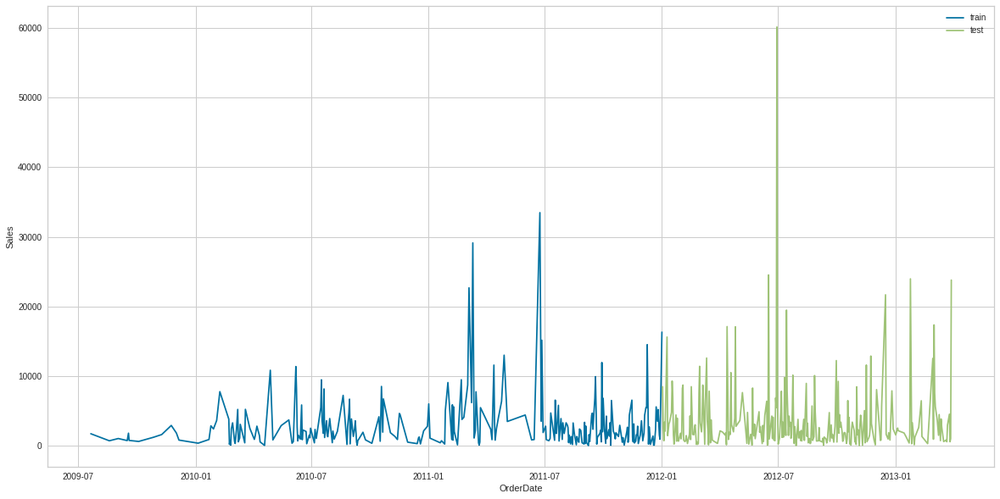

In [ ]:
aggregated=create_features(aggregated)
train, test = split_data(aggregated, '2012-01-01') # splitting the data for training before 2012-01-01

plt.figure(figsize=(20,10))
plt.xlabel('OrderDate')
plt.ylabel('Sales')
plt.plot(train.index,train['Sales'],label='train')
plt.plot(test.index,test['Sales'],label='test')
plt.legend()
plt.show()

In [ ]:
aggregated

,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,Sales
OrderDate,,,,,,,,
2009-07-21,1,3,7,2009,202,21,30,1734.95
2009-08-19,2,3,8,2009,231,19,34,723.95
2009-09-02,2,3,9,2009,245,2,36,1046.85
2009-09-16,2,3,9,2009,259,16,38,752.06
2009-09-18,4,3,9,2009,261,18,38,1817.20
...,...,...,...,...,...,...,...,...
2013-03-23,5,1,3,2013,82,23,12,2953.78
2013-03-26,1,1,3,2013,85,26,13,4545.50
2013-03-27,2,1,3,2013,86,27,13,587.14


There are a lot of variations in each separate date, also the dates are not consequitive, there are mising dates. There are two options in this situation: we can add the missing dates or leave the data as is. We will chose the latter option (not inserting the dates, leave the data as is) and the main reason for choosing the second option is that we are using this dataset for predictive modeling and not for time Series modeling. In predictive modeling the data does not take into account simply historic data with the dates/sales, but it also takes into account additional features.

In [ ]:
train.tail(4)

,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,Sales
OrderDate,,,,,,,,
2011-12-26,0,4,12,2011,360,26,52,5209.23
2011-12-28,2,4,12,2011,362,28,52,1528.75
2011-12-29,3,4,12,2011,363,29,52,942.60
2012-01-01,6,1,1,2012,1,1,52,16323.73


In [ ]:
test.head()

,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,Sales
OrderDate,,,,,,,,
2012-01-02,0,1,1,2012,2,2,1,8491.76
2012-01-03,1,1,1,2012,3,3,1,2509.32
2012-01-04,2,1,1,2012,4,4,1,725.96
2012-01-05,3,1,1,2012,5,5,1,3390.17
2012-01-06,4,1,1,2012,6,6,1,2103.43


In [ ]:
test.tail()

,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,Sales
OrderDate,,,,,,,,
2013-03-23,5,1,3,2013,82,23,12,2953.78
2013-03-26,1,1,3,2013,85,26,13,4545.50
2013-03-27,2,1,3,2013,86,27,13,587.14
2013-03-28,3,1,3,2013,87,28,13,1036.00
2013-03-29,4,1,3,2013,88,29,13,23799.16


#Run PyCaret

In [ ]:
reg = setup(data = train, 
             target = 'Sales',
             numeric_imputation = 'mean',
             categorical_features = ['dayofweek','quarter','month','year','dayofyear','dayofmonth','weekofyear']  , 
            transformation = True,
            transform_target_method = 'yeo-johnson',
            transform_target = True, 
                  combine_rare_levels = True, rare_level_threshold = 0.1,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
            feature_selection = True,
             silent = True)

,Description,Value
0,session_id,6026
1,Target,Sales
2,Original Data,"(270, 8)"
3,Missing Values,False
4,Numeric Features,0
5,Categorical Features,7
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(188, 116)"


create_model_container: 0
master_model_container: 0
display_container: 1
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['dayofweek',
                                                            'quarter', 'month',
                                                            'year', 'dayofyear',
                                                            'dayofmonth',
                                                            'weekofyear'],
                                      display_types=False, features_todrop=[],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=[], target='Sales',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_availabl...
                 Advanced_Feature_Selection_Classic(ml_usecase='regression',
                            

In [ ]:
# returns best models
top = compare_models() #n_select = 3

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,2.268846e+03,1.849635e+07,3779.3488,-0.0713,1.2352,2.336400e+00,0.088
br,Bayesian Ridge,2.202273e+03,1.965824e+07,3877.7041,-0.1146,1.2008,2.145900e+00,0.034
lasso,Lasso Regression,2.204090e+03,1.985694e+07,3902.5655,-0.1326,1.2027,2.126400e+00,0.021
dummy,Dummy Regressor,2.204090e+03,1.985694e+07,3902.5655,-0.1326,1.2027,2.126400e+00,0.016
llar,Lasso Least Angle Regression,2.204090e+03,1.985694e+07,3902.5655,-0.1326,1.2027,2.126400e+00,0.021
en,Elastic Net,2.204090e+03,1.985694e+07,3902.5655,-0.1326,1.2027,2.126400e+00,0.021
ada,AdaBoost Regressor,2.212332e+03,1.968753e+07,3891.2280,-0.1361,1.2000,1.987200e+00,0.082
knn,K Neighbors Regressor,2.319867e+03,1.925678e+07,3872.0393,-0.1522,1.2864,2.198200e+00,0.071
rf,Random Forest Regressor,2.401083e+03,2.056892e+07,4004.1758,-0.2161,1.3036,2.380200e+00,0.314
gbr,Gradient Boosting Regressor,2.524298e+03,2.160033e+07,4158.7958,-0.3522,1.3934,2.374600e+00,0.073


create_model_container: 18
master_model_container: 18
display_container: 2
PowerTransformedTargetRegressor(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=-1,
                                min_child_samples=20, min_child_weight=0.001,
                                min_split_gain=0.0, n_estimators=100, n_jobs=-1,
                                num_leaves=31, objective=None,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                random_sta...
                                                        importance_type='split',
                                                        learning_rate=0.1,
                                                        max_depth=-1,
                                                        min_child_samples=

In [ ]:
n_select = 3

#Creating baseline model

In [ ]:
#creating a model using lightgbm
lightgbm = create_model('lightgbm')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1587.7905,3.833623e+06,1957.9640,-0.0310,0.8729,1.2126
1,1740.5603,7.683054e+06,2771.8323,-0.2294,1.0776,1.1922
2,1621.6749,6.069263e+06,2463.5875,0.2006,1.1272,1.8543
3,1913.5221,7.811742e+06,2794.9493,-0.1303,1.2715,2.2018
4,1883.6143,7.221478e+06,2687.2808,-0.1089,1.6273,6.2445
5,2622.5260,2.748261e+07,5242.3855,-0.0367,1.3995,3.4282
6,3992.3138,6.121711e+07,7824.1362,-0.0596,1.2091,1.1275
7,3903.2769,5.189393e+07,7203.7441,-0.1438,1.5949,3.1381
8,1618.8291,5.987480e+06,2446.9327,0.0328,0.9355,0.9990


create_model_container: 19
master_model_container: 19
display_container: 3
PowerTransformedTargetRegressor(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=-1,
                                min_child_samples=20, min_child_weight=0.001,
                                min_split_gain=0.0, n_estimators=100, n_jobs=-1,
                                num_leaves=31, objective=None,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                random_sta...
                                                        importance_type='split',
                                                        learning_rate=0.1,
                                                        max_depth=-1,
                                                        min_child_samples=

In [ ]:
tuned_lightgbm = tune_model(lightgbm) 

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1401.4025,4.120575e+06,2029.9199,-0.1082,0.8647,0.9783
1,1471.5040,6.455054e+06,2540.6799,-0.0329,0.8926,1.0120
2,1439.9052,7.605744e+06,2757.8513,-0.0017,1.0648,1.5917
3,1793.9860,7.729900e+06,2780.2697,-0.1185,1.2465,2.3007
4,1919.6055,7.293102e+06,2700.5743,-0.1199,1.6106,5.9421
5,2523.5507,2.834653e+07,5324.1455,-0.0693,1.2943,2.0978
6,3897.7320,6.893115e+07,8302.4785,-0.1931,1.1918,0.7827
7,4043.8993,5.396317e+07,7345.9630,-0.1894,1.5690,3.0319
8,1761.6124,7.641856e+06,2764.3908,-0.2344,1.0173,1.1881


create_model_container: 20
master_model_container: 20
display_container: 4
PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samp

In [ ]:
tuned_lightgbm

PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
                                                        min_child_w

In [ ]:
#creating a model using br
br = create_model('br')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1378.8567,3.990383e+06,1997.5943,-0.0732,0.8540,0.9759
1,1458.0580,6.328730e+06,2515.6968,-0.0127,0.8804,0.9748
2,1439.3323,7.272505e+06,2696.7582,0.0422,1.0712,1.6472
3,1799.9876,7.713543e+06,2777.3265,-0.1161,1.2450,2.3056
4,1913.3415,7.330333e+06,2707.4587,-0.1256,1.6077,5.8806
5,2561.1697,2.857364e+07,5345.4319,-0.0779,1.3206,2.1936
6,3900.5910,6.845261e+07,8273.6090,-0.1848,1.1854,0.7923
7,4040.8038,5.364177e+07,7324.0545,-0.1823,1.5819,3.1967
8,1762.7675,7.625705e+06,2761.4679,-0.2318,1.0168,1.1896


create_model_container: 21
master_model_container: 21
display_container: 5
PowerTransformedTargetRegressor(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
                                compute_score=False, copy_X=True,
                                fit_intercept=True, lambda_1=1e-06,
                                lambda_2=1e-06, lambda_init=None, n_iter=300,
                                normalize=False,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                regressor=BayesianRidge(alpha_1=1e-06,
                                                        alpha_2=1e-06,
                                                        alpha_init=None,
                                                        compute_score=False,
                                                        copy_X=True,
                                                        fit_intercept=True,
        

In [ ]:
tuned_br = tune_model(br) 

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1365.8129,3.518018e+06,1875.6381,0.0538,0.8524,1.0242
1,1441.9090,5.989401e+06,2447.3254,0.0416,0.8716,0.8976
2,1504.1721,6.516839e+06,2552.8100,0.1417,1.1087,1.8435
3,1895.4981,8.146426e+06,2854.1944,-0.1788,1.2485,2.0897
4,1922.1750,7.764539e+06,2786.4922,-0.1923,1.6397,5.8002
5,2649.2855,2.945805e+07,5427.5270,-0.1113,1.3577,2.2244
6,4021.5916,6.555362e+07,8096.5187,-0.1347,1.2153,1.0384
7,4072.0350,5.391458e+07,7342.6551,-0.1884,1.6256,3.2564
8,1760.6475,7.542217e+06,2746.3097,-0.2183,1.0482,1.1757


create_model_container: 22
master_model_container: 22
display_container: 6
PowerTransformedTargetRegressor(alpha_1=0.2, alpha_2=0.05, alpha_init=None,
                                compute_score=False, copy_X=True,
                                fit_intercept=False, lambda_1=0.2, lambda_2=0.3,
                                lambda_init=None, n_iter=300, normalize=True,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                regressor=BayesianRidge(alpha_1=0.2,
                                                        alpha_2=0.05,
                                                        alpha_init=None,
                                                        compute_score=False,
                                                        copy_X=True,
                                                        fit_intercept=False,
                                                 

In [ ]:
tuned_br

PowerTransformedTargetRegressor(alpha_1=0.2, alpha_2=0.05, alpha_init=None,
                                compute_score=False, copy_X=True,
                                fit_intercept=False, lambda_1=0.2, lambda_2=0.3,
                                lambda_init=None, n_iter=300, normalize=True,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                regressor=BayesianRidge(alpha_1=0.2,
                                                        alpha_2=0.05,
                                                        alpha_init=None,
                                                        compute_score=False,
                                                        copy_X=True,
                                                        fit_intercept=False,
                                                        lambda_1=0.2,
                                                      

In [ ]:
#creating a model using lasso
lasso = create_model('lasso')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1412.2810,4.197606e+06,2048.8059,-0.1289,0.8723,0.9790
1,1465.8129,6.475729e+06,2544.7454,-0.0362,0.8921,1.0110
2,1427.6158,7.663350e+06,2768.2756,-0.0093,1.0600,1.5638
3,1799.2938,7.751354e+06,2784.1252,-0.1216,1.2490,2.3095
4,1929.3684,7.324197e+06,2706.3254,-0.1247,1.6160,5.9850
5,2518.3899,2.839803e+07,5328.9800,-0.0713,1.2907,2.0683
6,3890.8853,6.923486e+07,8320.7480,-0.1984,1.1932,0.7653
7,4051.7715,5.408735e+07,7354.4102,-0.1922,1.5688,2.9726
8,1772.9921,7.729026e+06,2780.1125,-0.2485,1.0281,1.2088


create_model_container: 23
master_model_container: 23
display_container: 7
PowerTransformedTargetRegressor(alpha=1.0, copy_X=True, fit_intercept=True,
                                max_iter=1000, normalize=False, positive=False,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                precompute=False, random_state=6026,
                                regressor=Lasso(alpha=1.0, copy_X=True,
                                                fit_intercept=True,
                                                max_iter=1000, normalize=False,
                                                positive=False,
                                                precompute=False,
                                                random_state=6026,
                                                selection='cyclic', tol=0.0001,
                                                warm_start=Fals

In [ ]:
tuned_lasso = tune_model(lasso)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1412.2810,4.197606e+06,2048.8059,-0.1289,0.8723,0.9790
1,1465.8129,6.475729e+06,2544.7454,-0.0362,0.8921,1.0110
2,1427.6158,7.663350e+06,2768.2756,-0.0093,1.0600,1.5638
3,1799.2938,7.751354e+06,2784.1252,-0.1216,1.2490,2.3095
4,1929.3684,7.324197e+06,2706.3254,-0.1247,1.6160,5.9850
5,2518.3899,2.839803e+07,5328.9800,-0.0713,1.2907,2.0683
6,3890.8853,6.923486e+07,8320.7480,-0.1984,1.1932,0.7653
7,4051.7715,5.408735e+07,7354.4102,-0.1922,1.5688,2.9726
8,1772.9921,7.729026e+06,2780.1125,-0.2485,1.0281,1.2088


create_model_container: 24
master_model_container: 24
display_container: 8
PowerTransformedTargetRegressor(alpha=1.13, copy_X=True, fit_intercept=True,
                                max_iter=1000, normalize=False, positive=False,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                precompute=False, random_state=6026,
                                regressor=Lasso(alpha=1.13, copy_X=True,
                                                fit_intercept=True,
                                                max_iter=1000, normalize=False,
                                                positive=False,
                                                precompute=False,
                                                random_state=6026,
                                                selection='cyclic', tol=0.0001,
                                                warm_start=Fa

In [ ]:
tuned_lasso

PowerTransformedTargetRegressor(alpha=1.13, copy_X=True, fit_intercept=True,
                                max_iter=1000, normalize=False, positive=False,
                                power_transformer_method='yeo-johnson',
                                power_transformer_standardize=True,
                                precompute=False, random_state=6026,
                                regressor=Lasso(alpha=1.13, copy_X=True,
                                                fit_intercept=True,
                                                max_iter=1000, normalize=False,
                                                positive=False,
                                                precompute=False,
                                                random_state=6026,
                                                selection='cyclic', tol=0.0001,
                                                warm_start=False),
                                selection='cyclic', tol=0.0001,
     

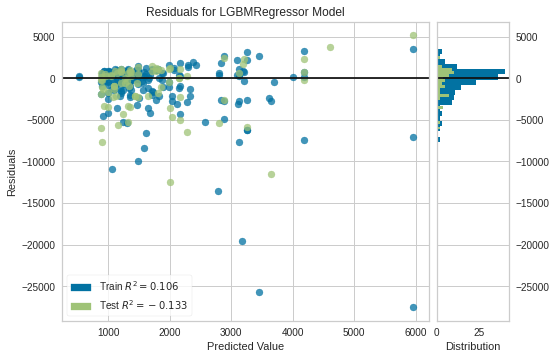

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(lightgbm)

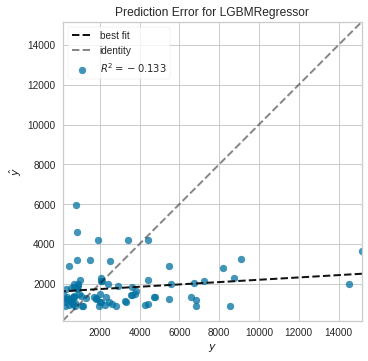

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(lightgbm, plot = 'error')

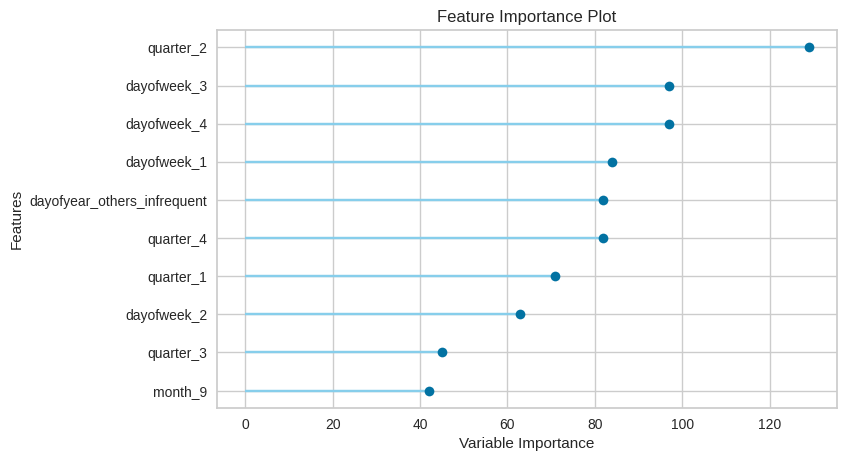

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_lightgbm, plot='feature')

In [ ]:
predict_model(tuned_lightgbm);

Initializing predict_model()
predict_model(estimator=PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
              

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,2043.7348,10223266.27,3197.3843,-0.1671,1.0632,1.262


In [ ]:
final_lightgbm = finalize_model(tuned_lightgbm)

Initializing finalize_model()
finalize_model(estimator=PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
            

In [ ]:
#Final Light Gradient Boosting Machine parameters for deployment
print(final_lightgbm)

PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
                                                        min_child_w

In [ ]:
predict_model(final_lightgbm);

Initializing predict_model()
predict_model(estimator=PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
              

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,2029.8071,1.004349e+07,3169.1469,-0.1466,1.0585,1.2956


In [ ]:
unseen_predictions = predict_model(final_lightgbm, data=test)
unseen_predictions.head()
unseen_predictions.loc[unseen_predictions['Label'] < 0, 'Label'] = 0 #removing any negative values

Initializing predict_model()
predict_model(estimator=PowerTransformedTargetRegressor(bagging_fraction=0.6, bagging_freq=3,
                                boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, feature_fraction=0.8,
                                importance_type='split', learning_rate=0.0005,
                                max_depth=-1, min_child_samples=11,
                                min_child_weight=0.001, min_split_gain=0.1,
                                n_estimators=260, n_jobs=-1, num_leaves=256,
                                objective=None,
                                power_transformer_metho...
                                                        importance_type='split',
                                                        learning_rate=0.0005,
                                                        max_depth=-1,
                                                        min_child_samples=11,
              

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,2717.7665,3.271989e+07,5720.1303,-0.1193,1.2494,2.1534


In [ ]:
def plot_series(time, series,i, format="-", start=0, end=None):
    #plt.figure(figsize=(20,10))
    plt.plot(time[start:end], series[start:end], format,label=i)
    plt.xlabel("OrderDate")
    plt.ylabel("Sales")
    plt.legend()

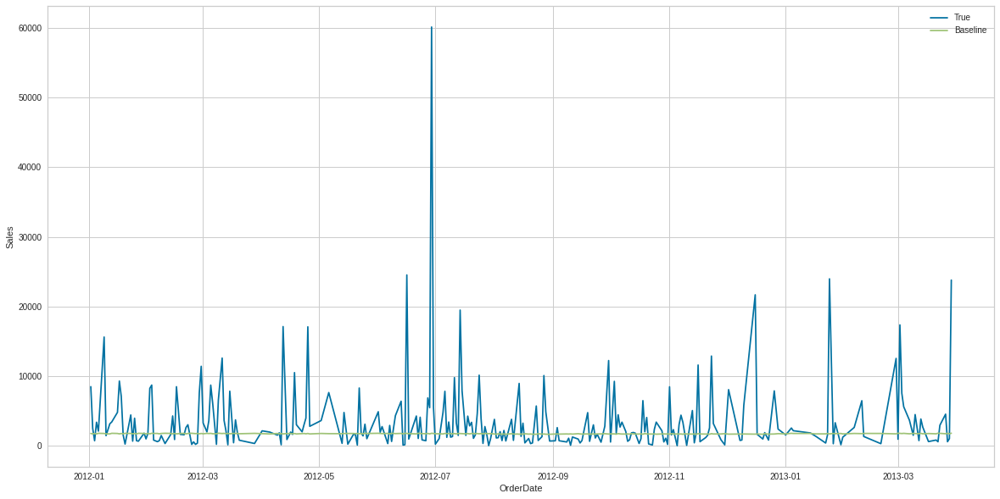

In [ ]:
plt.figure(figsize=(20,10))
plot_series(test.index, test['Sales'],"True")
#plot_series(train['ds'],train['y'])
plot_series(test.index, unseen_predictions['Label'],"Baseline")

In order to provide visualization in BI reporting, we used Tableau interactive analytical dashbord.

The main KPIs of our shop are presented on the first dashboard. We have performed clusterization of the customers, there are 5 clusters based on profit value. Sales values, categories of goods that are sold in our shop, and suppliers’ countries are presented on this dashboard.

In [ ]:
  %%html
<div class='tableauPlaceholder' id='viz1656244175827' style='position: relative'><noscript><a href='#'><img alt='Dashboard 1 ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Da&#47;DashboardwithKPIandClusterizationforCustomers&#47;Dashboard1&#47;1_rss.png' style='border: none' /></a></noscript><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='DashboardwithKPIandClusterizationforCustomers&#47;Dashboard1' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Da&#47;DashboardwithKPIandClusterizationforCustomers&#47;Dashboard1&#47;1.png' /> <param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1656244175827');                    var vizElement = divElement.getElementsByTagName('object')[0];                    if ( divElement.offsetWidth > 800 ) { vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';} else if ( divElement.offsetWidth > 500 ) { vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';} else { vizElement.style.width='100%';vizElement.style.height='1577px';}                     var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>

In [ ]:
%%html
<div class='tableauPlaceholder' id='viz1643292857762' style='position: relative'><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='DashboardwithKPIandClusterizationforCustomers&#47;Dashboard1' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /><param name='filter' value='publish=yes' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1643292857762');                    var vizElement = divElement.getElementsByTagName('object')[0];                    if ( divElement.offsetWidth > 800 ) { vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';} else if ( divElement.offsetWidth > 500 ) { vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';} else { vizElement.style.width='100%';vizElement.style.height='1577px';}                     var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>

In [ ]:
%%html
<div class='tableauPlaceholder' id='viz1643292560051' style='position: relative'><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='CustomerswiththeLowestProfit&#47;Story2' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /><param name='filter' value='publish=yes' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1643292560051');                    var vizElement = divElement.getElementsByTagName('object')[0];                    vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';                    var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>

In [ ]:
%%html
<div class='tableauPlaceholder' id='viz1656244325584' style='position: relative'><noscript><a href='#'><img alt='Story 3 ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Sa&#47;SalesForecastUsingTableauTS&#47;Story3&#47;1_rss.png' style='border: none' /></a></noscript><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='SalesForecastUsingTableauTS&#47;Story3' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;Sa&#47;SalesForecastUsingTableauTS&#47;Story3&#47;1.png' /> <param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='language' value='en-US' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1656244325584');                    var vizElement = divElement.getElementsByTagName('object')[0];                    vizElement.style.width='100%';vizElement.style.height=(divElement.offsetWidth*0.75)+'px';                    var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>